## Quick analysis of BGS truth table, and the failure modes

In [1]:
import os, sys, glob
import numpy as np

from astropy.io import fits
from astropy.table import Table, join, vstack
from astropy.io import fits

import pandas as pd
import fnmatch

import desispec.io

#import desispec
# library location will change ..
sys.path.append("/global/homes/r/rtojeiro/prospect/prospect/py")
from prospect import utils_specviewer,plotframes
import matplotlib.pyplot as plt 
fs = 15

In [2]:
tiledir   = '/global/cfs/cdirs/desi/spectro/redux/daily/tiles/'
tiles = ['66003']
nights = ['20200315']
petals = ['0','1', '2', '3', '4', '5', '6' ,'7', '8', '9']
obs_db = utils_specviewer.make_targetdict(tiledir, petals=petals, tiles=tiles) # tiles = optional 

In [31]:
def display_spectra(targetIDs, show_spectra=None):

    spectra, zcat= utils_specviewer.load_spectra_zcat_from_targets(targetIDs, tiledir, obs_db)
    # VI interface in notebook
    if show_spectra:
        plotframes.plotspectra(spectra, zcatalog=zcat, title='Target_select', notebook=True, mask_type='CMX_TARGET',with_vi_widgets=False)

### Read table

In [4]:
VI_dir = os.environ['HOME']+'/SV/VI_files/SV0/BGS/'
filename='truth_table_BGS_full_66003.txt'
tt = pd.read_csv(VI_dir+filename)
tt['dz'] = (tt['Redrock z'] - tt['best redshift'])/(1 + tt['best redshift'])

In [5]:
tt.keys()

Index(['Unnamed: 0', 'TargetID', 'Redrock z', 'Redrock spectype',
       'best redshift', 'best spectype', 'vi_combined_flag', 'N_VI',
       'DELTACHI2', 'FIBER', 'FLUX_G', 'FLUX_R', 'FLUX_Z', 'FIBERFLUX_G',
       'FIBERFLUX_R', 'FIBERFLUX_Z', 'MW_TRANSMISSION_G', 'MW_TRANSMISSION_R',
       'MW_TRANSMISSION_Z', 'TARGET_RA', 'TARGET_DEC', 'dz'],
      dtype='object')

## Histogram of combined flags
A combined flag is the mean of the flags of all inspectors in the cases where there are no conflicts, or a flag manually set by a merger in case of conflicts.

**We take all objects with a combined flag greater than 2.5 as secure.**

Text(0,0.5,'N')

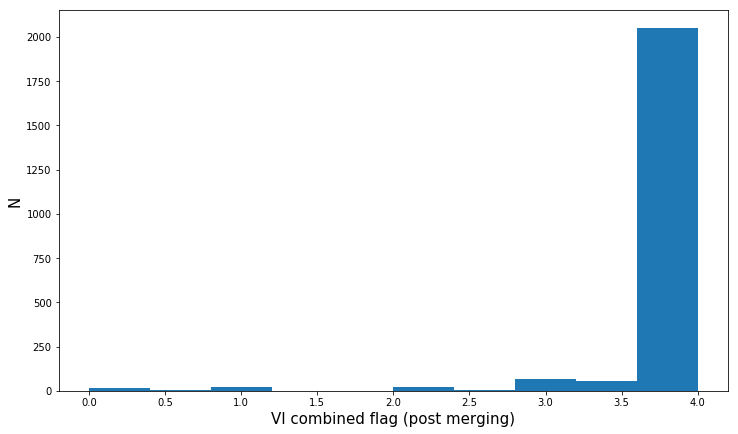

In [50]:
plt.figure(figsize=(12,7))
plt.hist(tt['vi_combined_flag'])
plt.xlabel('VI combined flag (post merging)', fontsize=fs)
plt.ylabel('N', fontsize=fs)

In [51]:
good = tt[tt['vi_combined_flag'] >=2.5]

In [52]:
print('fraction of secure redshifts: ',len(good)/len(tt))

fraction of secure redshifts:  0.9732262382864793


## Looking at the failures in more detail

We define **secure failures** as objects for which redrock got the wrong redshift, but VI provides a secure redshift.

We define **not secure failures** as objects for which redrock (probably) got the wrong redshift, and for which inspectors attempted an alternative redshift, but with low confidence.

We can then inspect each of these sets in a dedicated prospect window.

(below, we will also look at all spectra with poor VI flags)

Text(0,0.5,'Redrock z')

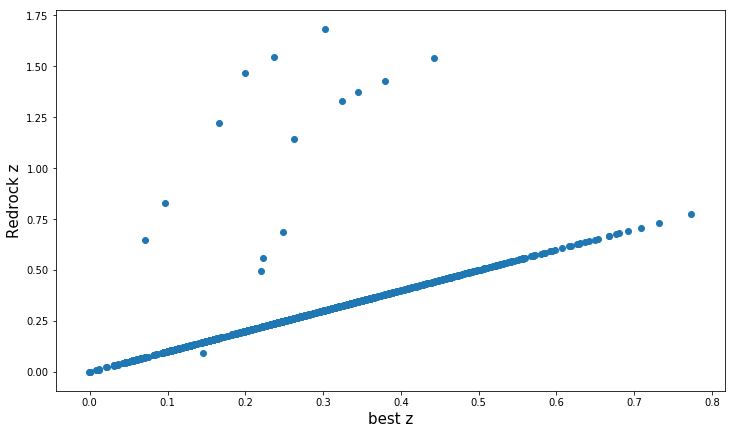

In [9]:
plt.figure(figsize=(12,7))
plt.scatter(good['best redshift'],good['Redrock z'] )
plt.xlabel('best z', fontsize=fs)
plt.ylabel('Redrock z', fontsize=fs)

In [48]:
fail_secure = tt[(np.abs(tt['dz'])>0.0033) & (tt['vi_combined_flag']>=2.5)]

In [49]:
fail_secure

,Unnamed: 0,TargetID,Redrock z,Redrock spectype,best redshift,best spectype,vi_combined_flag,N_VI,DELTACHI2,FIBER,...,FLUX_Z,FIBERFLUX_G,FIBERFLUX_R,FIBERFLUX_Z,MW_TRANSMISSION_G,MW_TRANSMISSION_R,MW_TRANSMISSION_Z,TARGET_RA,TARGET_DEC,dz
174,174,35191331831678391,1.4294,GALAXY,0.3801,GALAXY,3.000000,3,199.063396,552,...,16.753036,0.938533,2.791892,5.877492,0.961419,0.973845,0.985285,177.500444,57.737006,0.760307
352,352,35191335061293300,0.5589,GALAXY,0.2223,GALAXY,3.000000,3,4813.810518,970,...,124.886450,3.008784,7.927394,14.343959,0.957610,0.971244,0.983812,177.845174,58.038540,0.275382
890,890,35191341486966898,1.6827,GALAXY,0.3031,GALAXY,4.000000,4,427.185138,4271,...,8.521586,0.826716,1.515408,1.804755,0.943177,0.961359,0.978199,182.077415,58.603696,1.058706
910,910,35191344594944026,1.1448,GALAXY,0.2620,GALAXY,3.666667,3,3.896887,1481,...,11.872586,1.132619,2.791924,4.731554,0.950564,0.966424,0.981078,176.609162,58.625524,0.699525
930,930,35191344607528901,0.6461,GALAXY,0.0714,GALAXY,3.000000,3,6.769660,1420,...,13.045255,0.579729,0.857422,1.041389,0.930024,0.952308,0.973036,177.927339,58.772588,0.536401
944,944,35191344611724629,1.5402,GALAXY,0.4428,GALAXY,3.666667,3,220.095787,1832,...,13.871878,0.501494,1.523747,2.693106,0.921773,0.946608,0.969774,178.168555,58.866238,0.760604
963,963,35191344620111451,0.0940,GALAXY,0.1456,GALAXY,4.000000,3,2248.969952,711,...,32.657917,1.888149,3.515934,5.562430,0.962743,0.974748,0.985796,179.512883,58.744264,-0.045042
1052,1052,35191344641082107,0.8312,GALAXY,0.0972,GALAXY,3.000000,2,8.276761,4382,...,15.063485,1.383877,2.969075,4.619237,0.947617,0.964405,0.979931,181.615172,58.679792,0.668976
1218,1218,35191347757451573,0.6855,GALAXY,0.2482,GALAXY,3.000000,3,5.122789,2131,...,14.532964,0.997950,2.273605,3.759951,0.957141,0.970924,0.983630,179.330071,59.027419,0.350344
1476,1476,35191350878014538,1.2233,GALAXY,0.1663,GALAXY,3.000000,3,27.648384,2636,...,10.218941,0.639841,1.007682,1.487172,0.958673,0.971970,0.984223,179.634163,59.349288,0.906285


In [40]:
display_spectra(fail_secure['TargetID'].to_list(), show_spectra=True)

Loading BokehJS ...

In [41]:
fail_not_secure = tt[(np.abs(tt['dz'])>0.0033) & (tt['vi_combined_flag']<2.5)]

In [42]:
fail_not_secure

,Unnamed: 0,TargetID,Redrock z,Redrock spectype,best redshift,best spectype,vi_combined_flag,N_VI,DELTACHI2,FIBER,...,FLUX_Z,FIBERFLUX_G,FIBERFLUX_R,FIBERFLUX_Z,MW_TRANSMISSION_G,MW_TRANSMISSION_R,MW_TRANSMISSION_Z,TARGET_RA,TARGET_DEC,dz
11,11,35191325330507556,0.3928,GALAXY,0.4961,GALAXY,2.0,12,114.746243,485,...,17.541020,0.614623,2.513090,5.776959,0.883664,0.920064,0.954468,179.564392,57.254203,-0.069046
485,485,35191335090651685,1.0280,GALAXY,0.1816,GALAXY,2.0,4,7.970154,4843,...,9.599903,0.819008,1.532713,2.163553,0.936817,0.956987,0.975708,181.364682,57.910405,0.716317
690,690,35191338303489270,0.0938,GALAXY,0.1850,GALAXY,2.0,3,76.767697,4397,...,11.514951,1.198557,2.717132,4.498817,0.951925,0.967356,0.981607,181.978160,58.209084,-0.076962
884,884,35191341486965881,0.4640,GALAXY,0.0913,GALAXY,1.0,4,9.938609,4059,...,16.386139,0.597188,0.913134,1.243671,0.955933,0.970098,0.983162,182.378822,58.452479,0.341519
909,909,35191341491162469,0.5119,GALAXY,0.3136,GALAXY,1.0,3,3.853563,4484,...,16.657534,0.720621,1.536445,2.192235,0.949827,0.965920,0.980792,182.575856,58.623440,0.150959
1108,1108,35191347736478218,1.3463,GALAXY,0.0083,GALAXY,2.0,3,3.403816,1616,...,11.105669,0.155392,0.223445,0.396361,0.953203,0.968231,0.982104,176.808684,58.914255,1.326986
1260,1260,35191347770032748,0.5173,GALAXY,0.1240,QSO,1.0,3,28.635031,3983,...,10.172826,0.626472,1.092083,1.407992,0.963606,0.975336,0.986128,180.532271,58.933812,0.349911
1435,1435,35191350869626616,0.6054,GALAXY,0.7446,GALAXY,1.0,3,38.236967,2139,...,16.660295,0.355719,1.108549,2.872769,0.955529,0.969822,0.983006,178.883548,59.369498,-0.079789
1507,1507,35191350886400505,0.7130,GALAXY,1.1632,QSO,1.0,3,26.981060,3507,...,10.792073,1.151233,2.383609,3.544423,0.962641,0.974679,0.985756,180.504162,59.162855,-0.208118
1588,1588,35191353944048312,0.6682,GALAXY,0.0121,GALAXY,1.0,3,1.730728,1870,...,41.720783,0.243880,0.334562,0.412265,0.923722,0.947956,0.970546,176.871299,59.427914,0.648256


In [43]:
display_spectra(fail_not_secure['TargetID'].to_list(), show_spectra=True)

Loading BokehJS ...

## Looking at poor-quality spectra

More generally, we can look at ALL spectra with poor quality flags (for many of these, the redrock z will have been left untouched, and do not qualify as "failures")

In [59]:
not_secure = tt[tt['vi_combined_flag']<2.5]

In [57]:
not_secure

,Unnamed: 0,TargetID,Redrock z,Redrock spectype,best redshift,best spectype,vi_combined_flag,N_VI,DELTACHI2,FIBER,...,FLUX_Z,FIBERFLUX_G,FIBERFLUX_R,FIBERFLUX_Z,MW_TRANSMISSION_G,MW_TRANSMISSION_R,MW_TRANSMISSION_Z,TARGET_RA,TARGET_DEC,dz
11,11,35191325330507556,0.3928,GALAXY,0.4961,GALAXY,2.000000,12,114.746243,485,...,17.541020,0.614623,2.513090,5.776959,0.883664,0.920064,0.954468,179.564392,57.254203,-0.069046
15,15,35191325330508207,0.4173,GALAXY,0.4173,GALAXY,2.000000,13,438.923630,490,...,30.919426,1.080219,5.557986,12.944905,0.918063,0.944040,0.968302,179.818016,57.295672,0.000000
36,36,35191328585287825,1.6364,GALAXY,1.6364,GALAXY,1.000000,13,1.878102,674,...,15.137461,1.049200,2.512665,4.732416,0.950962,0.966697,0.981233,178.059146,57.520410,0.000000
145,145,35191328606260227,0.1467,GALAXY,0.1467,GALAXY,2.000000,3,38.623476,486,...,7.103888,0.402135,0.634566,0.747057,0.926939,0.950178,0.971819,180.333802,57.598690,0.000000
202,202,35191331840067186,0.0321,GALAXY,0.0321,GALAXY,2.500000,4,57.587463,858,...,12.391026,0.434838,0.729818,0.919668,0.949788,0.965893,0.980776,178.213566,57.753442,0.000000
229,229,35191331844262357,0.9396,GALAXY,0.9396,GALAXY,0.250000,4,4.651085,588,...,19.200180,0.268534,0.438288,0.561831,0.901296,0.932391,0.961600,178.884634,57.825652,0.000000
251,251,35191331848455971,0.4353,GALAXY,0.4353,GALAXY,2.000000,4,140.126668,19,...,22.175898,0.635042,2.274474,4.773534,0.902137,0.932977,0.961938,179.092149,57.754544,0.000000
337,337,35191335061291043,0.1035,GALAXY,0.1035,GALAXY,2.000000,3,188.500714,815,...,9.684713,0.522206,0.778971,1.008425,0.946972,0.963963,0.979679,178.074139,57.877105,0.000000
448,448,35191335078071217,1.5169,GALAXY,1.5169,GALAXY,0.000000,3,10.506469,271,...,43.842022,1.153633,6.086616,16.196812,0.942129,0.960639,0.977789,179.970092,58.102295,0.000000
458,458,35191335082264002,0.1008,GALAXY,0.1008,GALAXY,2.000000,4,15.841968,4978,...,11.285834,0.858586,1.843353,2.911359,0.947402,0.964258,0.979847,180.427073,57.973975,0.000000


In [60]:
display_spectra(not_secure['TargetID'].to_list(), show_spectra=True)

Loading BokehJS ...